In [31]:
# Importación de librerías necesarias
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.sparse import coo_matrix
from gtda.graphs import GraphGeodesicDistance
from gtda.homology import VietorisRipsPersistence, SparseRipsPersistence, FlagserPersistence
from igraph import Graph
from IPython.display import SVG, display
import plotly.graph_objects as go
import networkx as nx
from itertools import combinations
import argparse
import numpy as np
import gudhi
import matplotlib.pyplot as plot
import seaborn as sns
import networkx as nx
import plotly.graph_objects as go
import plotly.io as pio

In [32]:
def count_strains(labels):
    strain_counts = {}
    # Definir colores más brillantes y distinguibles
    strain_colors = {
        'H1N1': '#FF4136',    # Rojo brillante
        'H7N3': '#2ECC40',    # Verde brillante
        'H5N1': '#0074D9',    # Azul brillante
        'H3N2': '#FF851B',    # Naranja
        'H9N2': '#B10DC9',    # Púrpura
        'H12N1': '#01FF70',   # Verde lima
        'H10N7': '#FFD700'    # Amarillo dorado
    }
    for label in labels:
        strain = label.split('(')[1].split(')')[0]
        strain_counts[strain] = strain_counts.get(strain, 0) + 1
    print("Número de secuencias para la prueba:")
    for strain, count in strain_counts.items():
        color = strain_colors.get(strain, '#AAAAAA')  # Gris por defecto
        print(f"{strain} = {count} ({color})")
    return strain_colors

In [33]:
def visualize_simplicial_complex(simplex_tree, filtration_value, vertex_names=None, save_filename=None, plot_size=1000):
    G = nx.Graph()
    triangles = []
    tetrahedra = []
    edges = []
    hole_2d_simplices = []

    # Encontrar el agujero 2D
    persistence_2 = simplex_tree.persistence_intervals_in_dimension(2)
    # Inicializar hole_birth como None
    hole_birth = None
    if len(persistence_2) > 0 and persistence_2[0][0] is not None:
        hole_birth = persistence_2[0][0]  # Asumiendo que solo hay un agujero 2D

    # Procesar cada simplex en el árbol de simplex
    for simplex, filt in simplex_tree.get_filtration():
        if filt <= filtration_value:
            if len(simplex) == 2:
                G.add_edge(simplex[0], simplex[1])
                edges.append(simplex)
            elif len(simplex) == 1:
                G.add_node(simplex[0])
            elif len(simplex) == 3:
                triangles.append(simplex)
                # Solo agregar a hole_2d_simplices si hole_birth está definido y coincide
                if hole_birth is not None and abs(filt - hole_birth) < 1e-10:  # Comparación con tolerancia
                    hole_2d_simplices.append(simplex)
            elif len(simplex) == 4:
                tetrahedra.append(simplex)

    # Verificar si hay suficientes nodos para crear el grafo
    if len(G.nodes()) == 0:
        print("Warning: No hay nodos en el grafo para el valor de filtración dado")
        return None

    # Crear layout del grafo
    pos = nx.spring_layout(G, dim=3)

    # Obtener los colores de las cepas
    strain_colors = count_strains(vertex_names)

    # Crear trazas para nodos
    node_x, node_y, node_z = [], [], []
    node_labels = []
    node_colors = []
    
    for node in G.nodes():
        position = pos[node]
        node_x.append(position[0])
        node_y.append(position[1])
        node_z.append(position[2])
        label = vertex_names[node] if vertex_names else str(node)
        node_labels.append(label)
        strain = label.split('(')[1].split(')')[0]
        node_colors.append(strain_colors.get(strain, 'gray'))

    node_trace = go.Scatter3d(
        x=node_x, y=node_y, z=node_z,
        mode='markers+text',
        marker=dict(size=5, color=node_colors),
        text=node_labels,
        textposition="top center",
        hoverinfo='text'
    )

    # Crear trazas para aristas
    edge_x, edge_y, edge_z = [], [], []
    edge_colors = []
    for edge in G.edges():
        x0, y0, z0 = pos[edge[0]]
        x1, y1, z1 = pos[edge[1]]
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])
        edge_z.extend([z0, z1, None])
        # Comprobar si esta arista es parte del agujero 2D
        is_hole_edge = any(set(edge).issubset(triangle) for triangle in hole_2d_simplices)
        edge_colors.extend(['yellow' if is_hole_edge else 'black'] * 3)
    
    edge_trace = go.Scatter3d(
        x=edge_x, y=edge_y, z=edge_z,
        mode='lines',
        line=dict(width=2, color=edge_colors),
        hoverinfo='none'
    )

    # Crear trazas para triángulos
    triangle_traces = []
    for triangle in triangles:
        x = [pos[v][0] for v in triangle]
        y = [pos[v][1] for v in triangle]
        z = [pos[v][2] for v in triangle]
        color = 'yellow' if triangle in hole_2d_simplices else 'red'
        opacity = 0.7 if triangle in hole_2d_simplices else 0.3
        triangle_trace = go.Mesh3d(x=x, y=y, z=z, opacity=opacity, color=color)
        triangle_traces.append(triangle_trace)

    # Crear trazas para tetraedros
    tetrahedra_traces = []
    for tetrahedron in tetrahedra:
        x = [pos[v][0] for v in tetrahedron]
        y = [pos[v][1] for v in tetrahedron]
        z = [pos[v][2] for v in tetrahedron]
        tetrahedron_trace = go.Mesh3d(x=x, y=y, z=z, opacity=0.1, color='green')
        tetrahedra_traces.append(tetrahedron_trace)

    # Configurar el layout
    layout = go.Layout(
        scene=dict(
            xaxis=dict(visible=False),
            yaxis=dict(visible=False),
            zaxis=dict(visible=False)
        ),
        margin=dict(r=0, l=0, b=0, t=0),
        showlegend=False
    )

    # Crear la figura y añadir las trazas
    fig = go.Figure(data=[node_trace, edge_trace] + triangle_traces + tetrahedra_traces, layout=layout)

    fig.update_layout(width=plot_size, height=plot_size)

    if save_filename:
        fig.write_image(save_filename, width=plot_size, height=plot_size, scale=1)

    fig.show()

    return G

In [34]:
# Leer la matriz desde el archivo
sG3 = np.loadtxt('matriz_resultante(control_negativo_infA-B)(50).txt')

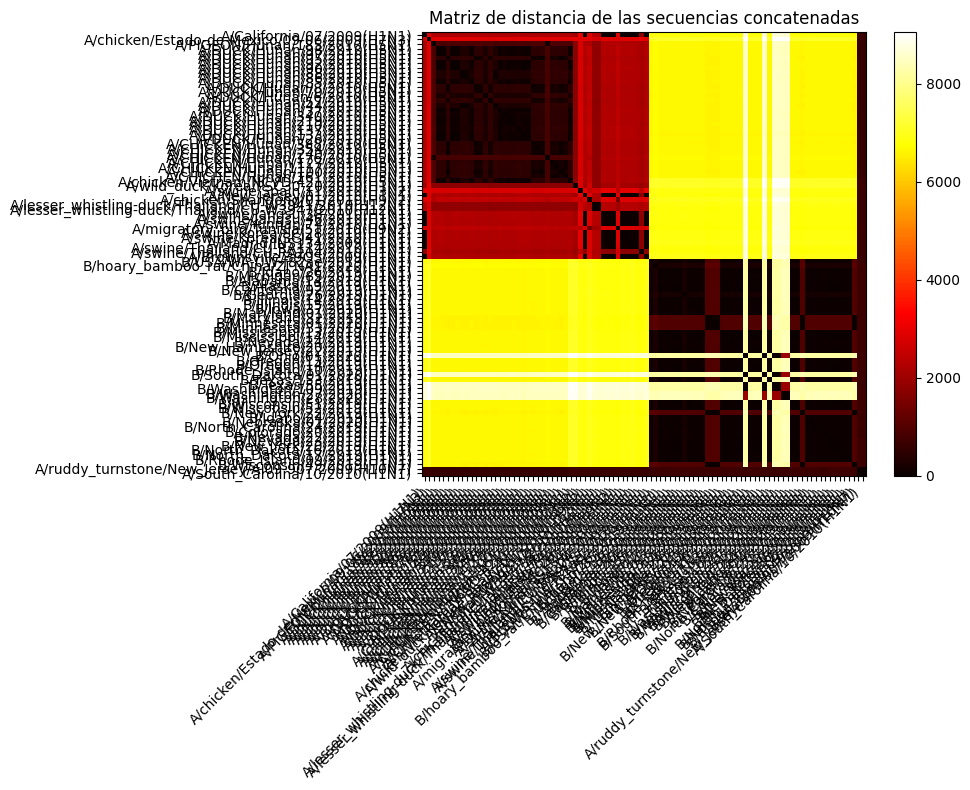

In [35]:
# Definir las etiquetas para las columnas y filas
labels = [
   'A/California/07/2009(H1N1)',
   'A/chicken/Estado-de-Mexico/09-06/2009(H7N3)',
   'A/PIGEON/Hunan/185/2010(H5N1)',
   'A/DUCK/Hunan/98/2010(H5N1)',
   'A/DUCK/Hunan/97/2010(H5N1)',
   'A/DUCK/Hunan/95/2010(H5N1)',
   'A/DUCK/Hunan/92/2010(H5N1)',
   'A/DUCK/Hunan/90/2010(H5N1)',
   'A/DUCK/Hunan/88/2010(H5N1)',
   'A/DUCK/Hunan/86/2010(H5N1)',
   'A/DUCK/Hunan/85/2010(H5N1)',
   'A/DUCK/Hunan/8/2010(H5N1)',
   'A/DUCK/Hunan/70/2010(H5N1)',
   'A/DUCK/Hunan/6/2010(H5N1)',
   'A/DUCK/Hunan/57/2010(H5N1)',
   'A/DUCK/Hunan/44/2010(H5N1)',
   'A/DUCK/Hunan/37/2010(H5N1)',
   'A/DUCK/Hunan/340/2010(H5N1)',
   'A/DUCK/Hunan/219/2010(H5N1)',
   'A/DUCK/Hunan/210/2010(H5N1)',
   'A/DUCK/Hunan/137/2010(H5N1)',
   'A/DUCK/Hunan/133/2010(H5N1)',
   'A/DUCK/Hunan/26/2010(H5N1)',
   'A/CHICKEN/Hunan/388/2010(H5N1)',
   'A/CHICKEN/Hunan/354/2010(H5N1)',
   'A/CHICKEN/Hunan/240/2010(H5N1)',
   'A/CHICKEN/Hunan/176/2010(H5N1)',
   'A/CHICKEN/Hunan/127/2010(H5N1)',
   'A/CHICKEN/Hunan/1117/2010(H5N1)',
   'A/CHICKEN/Hunan/100/2010(H5N1)',
   'A/CHICHEN/Hunan/161/2010(H5N1)',
   'A/chicken/Vietnam/NCVD-421/2010(H5N1)',
   'A/wild_duck/Korea/PSC30-20/2010(H1N1)',
   'A/swine/Spain/11/2010(H3N2)',
   'A/New_Jersey/01/2010(H1N1)',
   'A/chicken/Shandong/01/2010(H9N2)',
   'A/lesser_whistling-duck/Thailand/CU-W3941/2010(H12N1)',
   'A/lesser_whistling-duck/Thailand/CU-W3947/2010(H12N1)',
   'A/swine/Jangsu/38/2010(H1N1)',
   'A/swine/Jangsu/46/2010(H1N1)',
   'A/swine/Yunnan/74/2010(H1N1)',
   'A/migratory_bird/Tunisia/51/2010(H9N2)',
   'A/swine/Korea/SCJ28/2010(H1N1)',
   'A/swine/Korea/SCJ41/2010(H1N1)',
   'A/Madrid/INS134/2009(H1N1)',
   'A/swine/Thailand/CU-RA114/2010(H1N1)',
   'A/swine/Thailand/CU-RA204/2010(H1N1)',
   'A/Brownsville/39OS/2009(H1N1)',
   'B/USA/WA-UW-f82ae/2019(H1N1)',
   'B/hoary_bamboo_rat/China/ZJ-NA1/2020(H1N1)',
   'B/Idaho/26/2019(H1N1)',
   'B/Michigan/85/2019(H1N1)',
   'B/Alabama/14/2019(H1N1)',
   'B/Alaska/19/2019(H1N1)',
   'B/California/92/2019(H1N1)',
   'B/Georgia/26/2019(H1N1)',
   'B/Illinois/14/2019(H1N1)',
   'B/Illinois/15/2019(H1N1)',
   'B/Iowa/37/2019(H1N1)',
   'B/Maryland/01/2020(H1N1)',
   'B/Maryland/32/2019(H1N1)',
   'B/Minnesota/01/2020(H1N1)',
   'B/Minnesota/33/2019(H1N1)',
   'B/Mississippi/13/2019(H1N1)',
   'B/Mississippi/14/2019(H1N1)',
   'B/Nevada/24/2019(H1N1)',
   'B/New_Hampshire/20/2019(H1N1)',
   'B/New_Jersey/22/2019(H1N1)',
   'B/Ohio/01/2020(H1N1)',
   'B/Oregon/13/2019(H1N1)',
   'B/Oregon/14/2019(H1N1)',
   'B/Rhode_Island/10/2019(H1N1)',
   'B/South_Dakota/01/2020(H1N1)',
   'B/Texas/153/2019(H1N1)',
   'B/Texas/55/2019(H1N1)',
   'B/Washington/109/2019(H1N1)',
   'B/Washington/27/2020(H1N1)',
   'B/Washington/28/2020(H1N1)',
   'B/Wisconsin/51/2019(H1N1)',
   'B/Wisconsin/52/2019(H1N1)',
   'B/New_York/22/2019(H1N1)',
   'B/Idaho/24/2019(H1N1)',
   'B/Nebraska/01/2020(H1N1)',
   'B/North_Carolina/24/2019(H1N1)',
   'B/Colorado/20/2019(H1N1)',
   'B/Nevada/22/2019(H1N1)',
   'B/Nevada/23/2019(H1N1)',
   'B/New_York/20/2019(H1N1)',
   'B/North_Dakota/16/2019(H1N1)',
   'B/North_Dakota/17/2019(H1N1)',
   'B/Rhode_Island/09/2019(H1N1)',
   'B/Wisconsin/49/2019(H1N1)',
   'A/ruddy_turnstone/New_Jersey/AI09-907/2009(H10N7)',
   'A/South_Carolina/10/2010(H1N1)'
]
# Crea una figura con 1 fila y 1 columna
fig, ax = plot.subplots(1, 1, figsize=(10, 8))

# Grafica la matriz sG3 como una gráfica de calor
im = ax.imshow(sG3, cmap='hot')

# Personaliza el subplot
ax.set_title('Matriz de distancia de las secuencias concatenadas')

# Establece las posiciones y etiquetas para las columnas y filas
ax.set_xticks(np.arange(len(labels)))
ax.set_yticks(np.arange(len(labels)))
ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_yticklabels(labels)

# Agrega una barra de colores
cbar = fig.colorbar(im, ax=ax)

# Muestra la figura
plot.tight_layout()
plot.show()

In [36]:
# Configurar parámetros para el complejo de Rips
max_edge_length = 2300
max_dimension = 5
band = 0.0

print("#####################################################################")
print("RipsComplex creation from defined distance matrix G3")


# Crear el complejo de Rips
rips_complex = gudhi.RipsComplex(
   distance_matrix=sG3, max_edge_length=max_edge_length  
)

#####################################################################
RipsComplex creation from defined distance matrix G3


In [37]:
# Crear el árbol de simplex
simplex_tree = rips_complex.create_simplex_tree(max_dimension=max_dimension)
   
message = "Number of simplices=" + repr(simplex_tree.num_simplices()) 
print(message)

# Calcular la persistencia
diag = simplex_tree.persistence()

print("betti_numbers()=")
print(simplex_tree.betti_numbers())

Number of simplices=13372140
betti_numbers()=
[1, 0, 0, 0, 0]


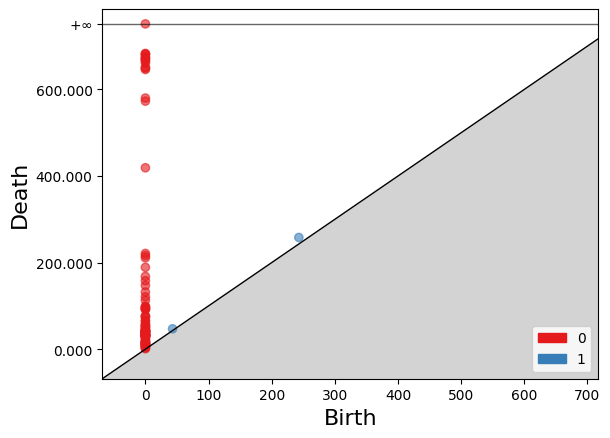

In [38]:
# Mostrar el diagrama de persistencia
gudhi.plot_persistence_diagram(diag, band=band)
plot.title("")
plot.show()

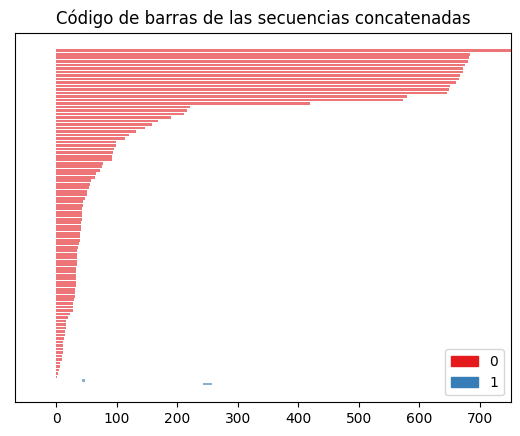

In [39]:
# Mostrar el código de barras
gudhi.plot_persistence_barcode(diag)
plot.title("Código de barras de las secuencias concatenadas")
plot.show()

In [40]:
simplex_tree = rips_complex.create_simplex_tree(max_dimension=max_dimension)
   
message = "Number of simplices=" + repr(simplex_tree.num_simplices()) 
print(message)
  
diag = simplex_tree.persistence()

print("betti_numbers()=")
print(simplex_tree.betti_numbers())

# Add this new code to print birth and death times for 1D and 2D holes
print("\nPersistence intervals for 1-dimensional holes:")
for interval in simplex_tree.persistence_intervals_in_dimension(1):
    print(f"Birth: {interval[0]}, Death: {interval[1]}")

print("\nPersistence intervals for 2-dimensional holes:")
for interval in simplex_tree.persistence_intervals_in_dimension(2):
    print(f"Birth: {interval[0]}, Death: {interval[1]}")

Number of simplices=13372140
betti_numbers()=
[1, 0, 0, 0, 0]

Persistence intervals for 1-dimensional holes:
Birth: 43.0, Death: 47.0
Birth: 243.0, Death: 258.0

Persistence intervals for 2-dimensional holes:


In [44]:
print("Visualizing 3D simplicial complex at filtration time 2025")
visualize_simplicial_complex(simplex_tree, 243, vertex_names=labels)


Visualizing 3D simplicial complex at filtration time 2025
Número de secuencias para la prueba:
H1N1 = 57 (#FF4136)
H7N3 = 1 (#2ECC40)
H5N1 = 30 (#0074D9)
H3N2 = 1 (#FF851B)
H9N2 = 2 (#B10DC9)
H12N1 = 2 (#01FF70)
H10N7 = 1 (#FFD700)


In [73]:
def filter_vertices_by_strain(vertex_names, target_strain):
    """
    Filtra los vértices para mantener solo los de una cepa específica
    """
    filtered_indices = {}
    for idx, name in enumerate(vertex_names):
        strain = name.split('(')[1].split(')')[0]
        if strain == target_strain:
            filtered_indices[idx] = name
    return filtered_indices

def analyze_strain_specific_hole(simplex_tree, filtration_time, vertex_names, target_strain):
    """
    Analiza los agujeros considerando solo las secuencias de una cepa específica
    """
    print(f"\nAnalizando agujeros en tiempo {filtration_time} para cepa {target_strain}...")
    
    # Filtrar vértices por cepa
    filtered_vertices = filter_vertices_by_strain(vertex_names, target_strain)
    
    if not filtered_vertices:
        print(f"No se encontraron secuencias de la cepa {target_strain}")
        return None
    
    print(f"\nSecuencias de {target_strain} encontradas:")
    for idx, name in filtered_vertices.items():
        print(f"- {name}")
    
    # Encontrar los agujeros activos en el tiempo de filtración
    persistence_intervals = simplex_tree.persistence_intervals_in_dimension(1)
    
    active_holes = []
    for interval in persistence_intervals:
        birth = float(interval[0])
        death = float(interval[1]) if interval[1] is not None else None
        
        if birth <= filtration_time and (death is None or death > filtration_time):
            active_holes.append((birth, death))
    
    if not active_holes:
        print(f"\nNo se encontraron agujeros activos en tiempo {filtration_time}")
        return None
    
    print(f"\nAgujeros activos en tiempo {filtration_time}:")
    for birth, death in active_holes:
        print(f"- Nace en: {birth}, Muere en: {death if death is not None else 'infinito'}")
    
    # Construir subgrafo con solo los vértices de la cepa específica
    G = nx.Graph()
    filtered_set = set(filtered_vertices.keys())
    
    for simplex, filt in simplex_tree.get_filtration():
        if len(simplex) == 2 and float(filt) <= filtration_time:
            if simplex[0] in filtered_set and simplex[1] in filtered_set:
                G.add_edge(simplex[0], simplex[1])
    
    # Encontrar ciclos en el subgrafo
    try:
        cycles = list(nx.cycle_basis(G))
        if cycles:
            print(f"\nCiclos encontrados entre secuencias de {target_strain}:")
            for i, cycle in enumerate(cycles):
                print(f"\nCiclo {i+1}:")
                for vertex in cycle:
                    print(f"- {filtered_vertices[vertex]}")
            return {'vertices': cycles[0], 'filtered_names': filtered_vertices}
        else:
            print(f"\nNo se encontraron ciclos entre secuencias de {target_strain}")
            return None
    except Exception as e:
        print(f"Error al buscar ciclos: {str(e)}")
        return None

def visualize_strain_specific_cycle(hole_data, plot_size=1000):
    """
    Visualiza el ciclo encontrado para una cepa específica
    """
    if not hole_data or 'vertices' not in hole_data or 'filtered_names' not in hole_data:
        print("No hay datos del ciclo para visualizar")
        return
        
    vertices = hole_data['vertices']
    vertex_names = hole_data['filtered_names']
    
    # Crear grafo con el ciclo
    G = nx.Graph()
    for i in range(len(vertices)):
        G.add_edge(vertices[i], vertices[(i+1) % len(vertices)])
    
    # Crear layout
    pos = nx.spring_layout(G, dim=3)
    
    # Crear trazas para nodos
    node_x, node_y, node_z = [], [], []
    node_labels = []
    
    for node in G.nodes():
        position = pos[node]
        node_x.append(position[0])
        node_y.append(position[1])
        node_z.append(position[2])
        node_labels.append(vertex_names[node])
    
    node_trace = go.Scatter3d(
        x=node_x, y=node_y, z=node_z,
        mode='markers+text',
        marker=dict(size=10, color='blue'),
        text=node_labels,
        textposition="top center",
        hoverinfo='text'
    )
    
    # Crear trazas para aristas
    edge_x, edge_y, edge_z = [], [], []
    for edge in G.edges():
        x0, y0, z0 = pos[edge[0]]
        x1, y1, z1 = pos[edge[1]]
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])
        edge_z.extend([z0, z1, None])
    
    edge_trace = go.Scatter3d(
        x=edge_x, y=edge_y, z=edge_z,
        mode='lines',
        line=dict(width=5, color='red'),
        hoverinfo='none'
    )
    
    # Configurar layout
    layout = go.Layout(
        scene=dict(
            xaxis=dict(visible=False),
            yaxis=dict(visible=False),
            zaxis=dict(visible=False)
        ),
        margin=dict(r=0, l=0, b=0, t=0),
        showlegend=False
    )
    
    # Crear figura
    fig = go.Figure(data=[node_trace, edge_trace], layout=layout)
    fig.update_layout(width=plot_size, height=plot_size)
    fig.show()

In [75]:
hole_data = analyze_strain_specific_hole(simplex_tree, 43, labels, "H1N1")



Analizando agujeros en tiempo 43 para cepa H1N1...

Secuencias de H1N1 encontradas:
- A/California/07/2009(H1N1)
- A/wild_duck/Korea/PSC30-20/2010(H1N1)
- A/New_Jersey/01/2010(H1N1)
- A/swine/Jangsu/38/2010(H1N1)
- A/swine/Jangsu/46/2010(H1N1)
- A/swine/Yunnan/74/2010(H1N1)
- A/swine/Korea/SCJ28/2010(H1N1)
- A/swine/Korea/SCJ41/2010(H1N1)
- A/Madrid/INS134/2009(H1N1)
- A/swine/Thailand/CU-RA114/2010(H1N1)
- A/swine/Thailand/CU-RA204/2010(H1N1)
- A/Brownsville/39OS/2009(H1N1)
- B/USA/WA-UW-f82ae/2019(H1N1)
- B/hoary_bamboo_rat/China/ZJ-NA1/2020(H1N1)
- B/Idaho/26/2019(H1N1)
- B/Michigan/85/2019(H1N1)
- B/Alabama/14/2019(H1N1)
- B/Alaska/19/2019(H1N1)
- B/California/92/2019(H1N1)
- B/Georgia/26/2019(H1N1)
- B/Illinois/14/2019(H1N1)
- B/Illinois/15/2019(H1N1)
- B/Iowa/37/2019(H1N1)
- B/Maryland/01/2020(H1N1)
- B/Maryland/32/2019(H1N1)
- B/Minnesota/01/2020(H1N1)
- B/Minnesota/33/2019(H1N1)
- B/Mississippi/13/2019(H1N1)
- B/Mississippi/14/2019(H1N1)
- B/Nevada/24/2019(H1N1)
- B/New_Hampsh

In [76]:
hole_data = analyze_strain_specific_hole(simplex_tree, 243, labels, "H5N1")


Analizando agujeros en tiempo 243 para cepa H5N1...

Secuencias de H5N1 encontradas:
- A/PIGEON/Hunan/185/2010(H5N1)
- A/DUCK/Hunan/98/2010(H5N1)
- A/DUCK/Hunan/97/2010(H5N1)
- A/DUCK/Hunan/95/2010(H5N1)
- A/DUCK/Hunan/92/2010(H5N1)
- A/DUCK/Hunan/90/2010(H5N1)
- A/DUCK/Hunan/88/2010(H5N1)
- A/DUCK/Hunan/86/2010(H5N1)
- A/DUCK/Hunan/85/2010(H5N1)
- A/DUCK/Hunan/8/2010(H5N1)
- A/DUCK/Hunan/70/2010(H5N1)
- A/DUCK/Hunan/6/2010(H5N1)
- A/DUCK/Hunan/57/2010(H5N1)
- A/DUCK/Hunan/44/2010(H5N1)
- A/DUCK/Hunan/37/2010(H5N1)
- A/DUCK/Hunan/340/2010(H5N1)
- A/DUCK/Hunan/219/2010(H5N1)
- A/DUCK/Hunan/210/2010(H5N1)
- A/DUCK/Hunan/137/2010(H5N1)
- A/DUCK/Hunan/133/2010(H5N1)
- A/DUCK/Hunan/26/2010(H5N1)
- A/CHICKEN/Hunan/388/2010(H5N1)
- A/CHICKEN/Hunan/354/2010(H5N1)
- A/CHICKEN/Hunan/240/2010(H5N1)
- A/CHICKEN/Hunan/176/2010(H5N1)
- A/CHICKEN/Hunan/127/2010(H5N1)
- A/CHICKEN/Hunan/1117/2010(H5N1)
- A/CHICKEN/Hunan/100/2010(H5N1)
- A/CHICHEN/Hunan/161/2010(H5N1)
- A/chicken/Vietnam/NCVD-421/2010(